<a href="https://colab.research.google.com/github/nnshoshin/projects/blob/main/praktikum_goldrecovery_shoshin.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Восстановление золота из руды

Модель должна предсказать коэффициент восстановления золота из золотосодержащей руды. Используйте данные с параметрами добычи и очистки. 

Модель поможет оптимизировать производство, чтобы не запускать предприятие с убыточными характеристиками.

## Подготовка данных

*Подгрузим необходимые библиотеки:*

In [ ]:
import pandas as pd
import numpy as np
from sklearn.metrics import mean_absolute_error

import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
from scipy import stats as st
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_absolute_error,  make_scorer
from sklearn.linear_model import LinearRegression
from sklearn.ensemble import RandomForestRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.model_selection import RandomizedSearchCV, cross_val_score
from sklearn.dummy import DummyRegressor
pd.set_option('display.max_rows', 100, 'display.max_columns', 100)
import warnings
warnings.filterwarnings('ignore') 

*Загрузим полученные данные:*

In [ ]:
data_train=pd.read_csv('/datasets/gold_recovery_train.csv')
data_test=pd.read_csv('/datasets/gold_recovery_test.csv')
data_full=pd.read_csv('/datasets/gold_recovery_full.csv')

*Взглянем на полученные данные:*

In [ ]:
data_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 16860 entries, 0 to 16859
Data columns (total 87 columns):
date                                                  16860 non-null object
final.output.concentrate_ag                           16788 non-null float64
final.output.concentrate_pb                           16788 non-null float64
final.output.concentrate_sol                          16490 non-null float64
final.output.concentrate_au                           16789 non-null float64
final.output.recovery                                 15339 non-null float64
final.output.tail_ag                                  16794 non-null float64
final.output.tail_pb                                  16677 non-null float64
final.output.tail_sol                                 16715 non-null float64
final.output.tail_au                                  16794 non-null float64
primary_cleaner.input.sulfate                         15553 non-null float64
primary_cleaner.input.depressant             

In [ ]:
data_train.describe()

,final.output.concentrate_ag,final.output.concentrate_pb,final.output.concentrate_sol,final.output.concentrate_au,final.output.recovery,final.output.tail_ag,final.output.tail_pb,final.output.tail_sol,final.output.tail_au,primary_cleaner.input.sulfate,primary_cleaner.input.depressant,primary_cleaner.input.feed_size,primary_cleaner.input.xanthate,primary_cleaner.output.concentrate_ag,primary_cleaner.output.concentrate_pb,primary_cleaner.output.concentrate_sol,primary_cleaner.output.concentrate_au,primary_cleaner.output.tail_ag,primary_cleaner.output.tail_pb,primary_cleaner.output.tail_sol,primary_cleaner.output.tail_au,primary_cleaner.state.floatbank8_a_air,primary_cleaner.state.floatbank8_a_level,primary_cleaner.state.floatbank8_b_air,primary_cleaner.state.floatbank8_b_level,primary_cleaner.state.floatbank8_c_air,primary_cleaner.state.floatbank8_c_level,primary_cleaner.state.floatbank8_d_air,primary_cleaner.state.floatbank8_d_level,rougher.calculation.sulfate_to_au_concentrate,rougher.calculation.floatbank10_sulfate_to_au_feed,rougher.calculation.floatbank11_sulfate_to_au_feed,rougher.calculation.au_pb_ratio,rougher.input.feed_ag,rougher.input.feed_pb,rougher.input.feed_rate,rougher.input.feed_size,rougher.input.feed_sol,rougher.input.feed_au,rougher.input.floatbank10_sulfate,rougher.input.floatbank10_xanthate,rougher.input.floatbank11_sulfate,rougher.input.floatbank11_xanthate,rougher.output.concentrate_ag,rougher.output.concentrate_pb,rougher.output.concentrate_sol,rougher.output.concentrate_au,rougher.output.recovery,rougher.output.tail_ag,rougher.output.tail_pb,rougher.output.tail_sol,rougher.output.tail_au,rougher.state.floatbank10_a_air,rougher.state.floatbank10_a_level,rougher.state.floatbank10_b_air,rougher.state.floatbank10_b_level,rougher.state.floatbank10_c_air,rougher.state.floatbank10_c_level,rougher.state.floatbank10_d_air,rougher.state.floatbank10_d_level,rougher.state.floatbank10_e_air,rougher.state.floatbank10_e_level,rougher.state.floatbank10_f_air,rougher.state.floatbank10_f_level,secondary_cleaner.output.tail_ag,secondary_cleaner.output.tail_pb,secondary_cleaner.output.tail_sol,secondary_cleaner.output.tail_au,secondary_cleaner.state.floatbank2_a_air,secondary_cleaner.state.floatbank2_a_level,secondary_cleaner.state.floatbank2_b_air,secondary_cleaner.state.floatbank2_b_level,secondary_cleaner.state.floatbank3_a_air,secondary_cleaner.state.floatbank3_a_level,secondary_cleaner.state.floatbank3_b_air,secondary_cleaner.state.floatbank3_b_level,secondary_cleaner.state.floatbank4_a_air,secondary_cleaner.state.floatbank4_a_level,secondary_cleaner.state.floatbank4_b_air,secondary_cleaner.state.floatbank4_b_level,secondary_cleaner.state.floatbank5_a_air,secondary_cleaner.state.floatbank5_a_level,secondary_cleaner.state.floatbank5_b_air,secondary_cleaner.state.floatbank5_b_level,secondary_cleaner.state.floatbank6_a_air,secondary_cleaner.state.floatbank6_a_level
count,16788.000000,16788.000000,16490.000000,16789.000000,15339.000000,16794.000000,16677.000000,16715.000000,16794.000000,15553.000000,15598.000000,16860.000000,15875.000000,16778.000000,16502.000000,16224.000000,16778.000000,16777.000000,16761.000000,16579.000000,16777.000000,16820.000000,16827.000000,16820.000000,16833.000000,16822.000000,16833.000000,16821.000000,16833.000000,1.683300e+04,1.683300e+04,1.683300e+04,15618.000000,16778.000000,16632.000000,16347.000000,16443.000000,16568.000000,16777.000000,15816.000000,16514.000000,16237.000000,14956.000000,16778.000000,16778.000000,16698.000000,16778.000000,14287.000000,14610.000000,16778.000000,14611.000000,14611.000000,16807.000000,16807.000000,16807.000000,16807.000000,16807.000000,16814.000000,16802.000000,16809.000000,16257.000000,16809.000000,16802.000000,16802.000000,16776.000000,16764.000000,14874.000000,16778.000000,16497.000000,16751.000000,16705.000000,16748.000000,16763.000000,16747.000000,16752.000000,16750.000000,16731.000000,16747.000000,16768.000000,16767.000000,16775.000000,16775.000000,16775

In [ ]:
data_train.nunique()

date                                                  16860
final.output.concentrate_ag                           15080
final.output.concentrate_pb                           15060
final.output.concentrate_sol                          14778
final.output.concentrate_au                           15081
final.output.recovery                                 14766
final.output.tail_ag                                  15119
final.output.tail_pb                                  15002
final.output.tail_sol                                 15040
final.output.tail_au                                  15119
primary_cleaner.input.sulfate                         15553
primary_cleaner.input.depressant                      15540
primary_cleaner.input.feed_size                        3936
primary_cleaner.input.xanthate                        15875
primary_cleaner.output.concentrate_ag                 15014
primary_cleaner.output.concentrate_pb                 14730
primary_cleaner.output.concentrate_sol  

In [ ]:
data_train.duplicated().sum()

0

In [ ]:
data_test.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5856 entries, 0 to 5855
Data columns (total 53 columns):
date                                          5856 non-null object
primary_cleaner.input.sulfate                 5554 non-null float64
primary_cleaner.input.depressant              5572 non-null float64
primary_cleaner.input.feed_size               5856 non-null float64
primary_cleaner.input.xanthate                5690 non-null float64
primary_cleaner.state.floatbank8_a_air        5840 non-null float64
primary_cleaner.state.floatbank8_a_level      5840 non-null float64
primary_cleaner.state.floatbank8_b_air        5840 non-null float64
primary_cleaner.state.floatbank8_b_level      5840 non-null float64
primary_cleaner.state.floatbank8_c_air        5840 non-null float64
primary_cleaner.state.floatbank8_c_level      5840 non-null float64
primary_cleaner.state.floatbank8_d_air        5840 non-null float64
primary_cleaner.state.floatbank8_d_level      5840 non-null float64
rougher.in

In [ ]:
data_test.describe()

,primary_cleaner.input.sulfate,primary_cleaner.input.depressant,primary_cleaner.input.feed_size,primary_cleaner.input.xanthate,primary_cleaner.state.floatbank8_a_air,primary_cleaner.state.floatbank8_a_level,primary_cleaner.state.floatbank8_b_air,primary_cleaner.state.floatbank8_b_level,primary_cleaner.state.floatbank8_c_air,primary_cleaner.state.floatbank8_c_level,primary_cleaner.state.floatbank8_d_air,primary_cleaner.state.floatbank8_d_level,rougher.input.feed_ag,rougher.input.feed_pb,rougher.input.feed_rate,rougher.input.feed_size,rougher.input.feed_sol,rougher.input.feed_au,rougher.input.floatbank10_sulfate,rougher.input.floatbank10_xanthate,rougher.input.floatbank11_sulfate,rougher.input.floatbank11_xanthate,rougher.state.floatbank10_a_air,rougher.state.floatbank10_a_level,rougher.state.floatbank10_b_air,rougher.state.floatbank10_b_level,rougher.state.floatbank10_c_air,rougher.state.floatbank10_c_level,rougher.state.floatbank10_d_air,rougher.state.floatbank10_d_level,rougher.state.floatbank10_e_air,rougher.state.floatbank10_e_level,rougher.state.floatbank10_f_air,rougher.state.floatbank10_f_level,secondary_cleaner.state.floatbank2_a_air,secondary_cleaner.state.floatbank2_a_level,secondary_cleaner.state.floatbank2_b_air,secondary_cleaner.state.floatbank2_b_level,secondary_cleaner.state.floatbank3_a_air,secondary_cleaner.state.floatbank3_a_level,secondary_cleaner.state.floatbank3_b_air,secondary_cleaner.state.floatbank3_b_level,secondary_cleaner.state.floatbank4_a_air,secondary_cleaner.state.floatbank4_a_level,secondary_cleaner.state.floatbank4_b_air,secondary_cleaner.state.floatbank4_b_level,secondary_cleaner.state.floatbank5_a_air,secondary_cleaner.state.floatbank5_a_level,secondary_cleaner.state.floatbank5_b_air,secondary_cleaner.state.floatbank5_b_level,secondary_cleaner.state.floatbank6_a_air,secondary_cleaner.state.floatbank6_a_level
count,5554.000000,5572.000000,5856.000000,5690.000000,5840.000000,5840.000000,5840.000000,5840.000000,5840.000000,5840.000000,5840.000000,5840.000000,5840.000000,5840.000000,5816.000000,5834.000000,5789.000000,5840.000000,5599.000000,5733.000000,5801.000000,5503.000000,5839.000000,5840.000000,5839.000000,5840.000000,5839.000000,5840.000000,5839.000000,5840.000000,5839.000000,5840.000000,5839.000000,5840.000000,5836.000000,5840.000000,5833.000000,5840.000000,5822.000000,5840.000000,5840.000000,5840.000000,5840.000000,5840.000000,5840.000000,5840.000000,5840.000000,5840.000000,5840.000000,5840.000000,5840.000000,5840.000000
mean,170.515243,8.482873,7.264651,1.321420,1481.990241,-509.057796,1486.908670,-511.743956,1468.495216,-509.741212,1486.398557,-510.723606,8.736170,3.552722,458.485472,55.937535,35.105834,8.700930,13.439933,6.169553,13.056047,6.423566,1016.294703,-404.977728,1270.598553,-482.154567,1253.495045,-480.945868,1169.675564,-482.152253,1018.386311,-476.551547,962.005375,-477.795380,25.479808,-513.714941,21.083475,-512.325717,24.345831,-519.417733,20.068079,-515.028316,15.636031,-516.266074,13.145702,-476.338907,12.308967,-512.208126,9.470986,-505.017827,16.678722,-512.351694
std,49.608602,3.353105,0.611526,0.693246,310.453166,61.339256,313.224286,67.139074,309.980748,62.671873,313.725248,65.417633,2.985805,1.326113,155.958272,22.724254,10.793249,2.803046,3.997715,1.673606,4.533948,1.120371,226.494775,100.953782,285.247715,55.399631,290.703157,53.759053,285.407244,54.967985,231.675756,67.002595,220.862435,68.342305,5.450424,62.448366,5.940017,63.376776,7.950733,73.968109,7.644391,60.457838,4.660835,62.756748,4.304086,105.549424,3.762827,58.864651,3.312471,68.785898,5.404514,69.919839
min,0.000103,0.000031,5.650000,0.000003,0.000000,-799.773788,0.000000,-800.029078,0.000000,-799.995127,0.000000,-799.838846,0.000000,0.000000,0.002986,0.046369,0.000000,0.000000,0.000154,0.000052,0.000014,0.000055,-0.123194,-657.949759,-0.821921,-650.349159,-0.282087,-650.000000,-1.047388,-648.390665,-2.076798,-650.152533,-2.593390,-650.034631,0.000000,-799.608557,0.000000,-798.467243,0.000000,-799.7

In [ ]:
data_test.nunique()

date                                          5856
primary_cleaner.input.sulfate                 5554
primary_cleaner.input.depressant              5572
primary_cleaner.input.feed_size               1565
primary_cleaner.input.xanthate                5690
primary_cleaner.state.floatbank8_a_air        5674
primary_cleaner.state.floatbank8_a_level      5839
primary_cleaner.state.floatbank8_b_air        5689
primary_cleaner.state.floatbank8_b_level      5840
primary_cleaner.state.floatbank8_c_air        5720
primary_cleaner.state.floatbank8_c_level      5840
primary_cleaner.state.floatbank8_d_air        5727
primary_cleaner.state.floatbank8_d_level      5840
rougher.input.feed_ag                         5465
rougher.input.feed_pb                         5464
rougher.input.feed_rate                       5816
rougher.input.feed_size                       5834
rougher.input.feed_sol                        5412
rougher.input.feed_au                         5465
rougher.input.floatbank10_sulfa

In [ ]:
data_test.duplicated().sum()

0

In [ ]:
data_full.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 22716 entries, 0 to 22715
Data columns (total 87 columns):
date                                                  22716 non-null object
final.output.concentrate_ag                           22627 non-null float64
final.output.concentrate_pb                           22629 non-null float64
final.output.concentrate_sol                          22331 non-null float64
final.output.concentrate_au                           22630 non-null float64
final.output.recovery                                 20753 non-null float64
final.output.tail_ag                                  22633 non-null float64
final.output.tail_pb                                  22516 non-null float64
final.output.tail_sol                                 22445 non-null float64
final.output.tail_au                                  22635 non-null float64
primary_cleaner.input.sulfate                         21107 non-null float64
primary_cleaner.input.depressant             

In [ ]:
data_full.describe()

,final.output.concentrate_ag,final.output.concentrate_pb,final.output.concentrate_sol,final.output.concentrate_au,final.output.recovery,final.output.tail_ag,final.output.tail_pb,final.output.tail_sol,final.output.tail_au,primary_cleaner.input.sulfate,primary_cleaner.input.depressant,primary_cleaner.input.feed_size,primary_cleaner.input.xanthate,primary_cleaner.output.concentrate_ag,primary_cleaner.output.concentrate_pb,primary_cleaner.output.concentrate_sol,primary_cleaner.output.concentrate_au,primary_cleaner.output.tail_ag,primary_cleaner.output.tail_pb,primary_cleaner.output.tail_sol,primary_cleaner.output.tail_au,primary_cleaner.state.floatbank8_a_air,primary_cleaner.state.floatbank8_a_level,primary_cleaner.state.floatbank8_b_air,primary_cleaner.state.floatbank8_b_level,primary_cleaner.state.floatbank8_c_air,primary_cleaner.state.floatbank8_c_level,primary_cleaner.state.floatbank8_d_air,primary_cleaner.state.floatbank8_d_level,rougher.calculation.sulfate_to_au_concentrate,rougher.calculation.floatbank10_sulfate_to_au_feed,rougher.calculation.floatbank11_sulfate_to_au_feed,rougher.calculation.au_pb_ratio,rougher.input.feed_ag,rougher.input.feed_pb,rougher.input.feed_rate,rougher.input.feed_size,rougher.input.feed_sol,rougher.input.feed_au,rougher.input.floatbank10_sulfate,rougher.input.floatbank10_xanthate,rougher.input.floatbank11_sulfate,rougher.input.floatbank11_xanthate,rougher.output.concentrate_ag,rougher.output.concentrate_pb,rougher.output.concentrate_sol,rougher.output.concentrate_au,rougher.output.recovery,rougher.output.tail_ag,rougher.output.tail_pb,rougher.output.tail_sol,rougher.output.tail_au,rougher.state.floatbank10_a_air,rougher.state.floatbank10_a_level,rougher.state.floatbank10_b_air,rougher.state.floatbank10_b_level,rougher.state.floatbank10_c_air,rougher.state.floatbank10_c_level,rougher.state.floatbank10_d_air,rougher.state.floatbank10_d_level,rougher.state.floatbank10_e_air,rougher.state.floatbank10_e_level,rougher.state.floatbank10_f_air,rougher.state.floatbank10_f_level,secondary_cleaner.output.tail_ag,secondary_cleaner.output.tail_pb,secondary_cleaner.output.tail_sol,secondary_cleaner.output.tail_au,secondary_cleaner.state.floatbank2_a_air,secondary_cleaner.state.floatbank2_a_level,secondary_cleaner.state.floatbank2_b_air,secondary_cleaner.state.floatbank2_b_level,secondary_cleaner.state.floatbank3_a_air,secondary_cleaner.state.floatbank3_a_level,secondary_cleaner.state.floatbank3_b_air,secondary_cleaner.state.floatbank3_b_level,secondary_cleaner.state.floatbank4_a_air,secondary_cleaner.state.floatbank4_a_level,secondary_cleaner.state.floatbank4_b_air,secondary_cleaner.state.floatbank4_b_level,secondary_cleaner.state.floatbank5_a_air,secondary_cleaner.state.floatbank5_a_level,secondary_cleaner.state.floatbank5_b_air,secondary_cleaner.state.floatbank5_b_level,secondary_cleaner.state.floatbank6_a_air,secondary_cleaner.state.floatbank6_a_level
count,22627.000000,22629.000000,22331.000000,22630.000000,20753.000000,22633.000000,22516.000000,22445.000000,22635.000000,21107.000000,21170.000000,22716.000000,21565.000000,22618.000000,22268.000000,21918.000000,22618.000000,22614.000000,22594.000000,22365.000000,22617.000000,22660.000000,22667.000000,22660.000000,22673.000000,22662.000000,22673.000000,22661.000000,22673.000000,2.267200e+04,2.267200e+04,2.267200e+04,21089.000000,22618.000000,22472.000000,22163.000000,22277.000000,22357.000000,22617.000000,21415.000000,22247.000000,22038.000000,20459.000000,22618.000000,22618.000000,22526.000000,22618.000000,19597.000000,19979.000000,22618.000000,19980.000000,19980.000000,22646.000000,22647.000000,22646.000000,22647.000000,22646.000000,22654.000000,22641.000000,22649.000000,22096.000000,22649.000000,22641.000000,22642.000000,22616.000000,22600.000000,20501.000000,22618.000000,22333.000000,22591.000000,22538.000000,22588.000000,22585.000000,22587.000000,22592.000000,22590.000000,22571.000000,22587.000000,22608.000000,22607.000000,22615.000000,22615.000000,22615

In [ ]:
data_full.nunique() 

date                                                  22716
final.output.concentrate_ag                           20480
final.output.concentrate_pb                           20444
final.output.concentrate_sol                          20177
final.output.concentrate_au                           20483
final.output.recovery                                 20090
final.output.tail_ag                                  20579
final.output.tail_pb                                  20462
final.output.tail_sol                                 20470
final.output.tail_au                                  20581
primary_cleaner.input.sulfate                         21107
primary_cleaner.input.depressant                      21111
primary_cleaner.input.feed_size                        5253
primary_cleaner.input.xanthate                        21565
primary_cleaner.output.concentrate_ag                 20451
primary_cleaner.output.concentrate_pb                 20072
primary_cleaner.output.concentrate_sol  

In [ ]:
data_full.duplicated().sum()

0

In [ ]:
data_full.set_index('date', inplace=True)
data_train.set_index('date', inplace=True)
data_test.set_index('date', inplace=True)


Данные состоят из 22716 строк, 16860 из которых относятся к обучающей выборке, а 5856 - к тестовой. Столбец дата содержит неповторяющиеся значения, поэтому этот столбец можно сделать индексом. В данных наблюдается достаточно большое количество пропусков. Если удалить все имеющиеся пропуски - теряется около 30% данных, это очень много, поэтому удалять их не стоит. 

Проверим точность расчёта эффективности обогащения.

In [ ]:
data_train['rougher.output.recovery_calculated']=data_train['rougher.output.concentrate_au']*(data_train['rougher.input.feed_au']-data_train['rougher.output.tail_au'])/data_train['rougher.input.feed_au']*100/(data_train['rougher.output.concentrate_au']-data_train['rougher.output.tail_au'])

In [ ]:
data_train[['rougher.output.recovery_calculated', 'rougher.output.recovery']].dropna().describe()

,rougher.output.recovery_calculated,rougher.output.recovery
count,14287.000000,14287.000000
mean,82.394201,82.394201
std,15.096808,15.096808
min,-0.000000,0.000000
25%,79.818372,79.818372
50%,85.235997,85.235997
75%,90.131691,90.131691
max,100.000000,100.000000


In [ ]:
df_recovery = data_train[['rougher.output.recovery_calculated', 'rougher.output.recovery']].dropna()
print(mean_absolute_error(df_recovery['rougher.output.recovery_calculated'], df_recovery['rougher.output.recovery']))

1.1161521921746e-14


В результате расчета эффективность обогащения по формуле и сравнения значений с имеющимися выяснилось, что имеющиеся значения посчитаны верно, MAE совсем незначительно, возникло скорее всего из-за округления значений. 

Проверим, какие признаки отсутствуют в тестовой выборке:

In [ ]:
missing_features = []

for element in data_train.columns:
    if element not in data_test.columns:
        missing_features.append(element)
for i in missing_features:
    print(i)


final.output.concentrate_ag
final.output.concentrate_pb
final.output.concentrate_sol
final.output.concentrate_au
final.output.recovery
final.output.tail_ag
final.output.tail_pb
final.output.tail_sol
final.output.tail_au
primary_cleaner.output.concentrate_ag
primary_cleaner.output.concentrate_pb
primary_cleaner.output.concentrate_sol
primary_cleaner.output.concentrate_au
primary_cleaner.output.tail_ag
primary_cleaner.output.tail_pb
primary_cleaner.output.tail_sol
primary_cleaner.output.tail_au
rougher.calculation.sulfate_to_au_concentrate
rougher.calculation.floatbank10_sulfate_to_au_feed
rougher.calculation.floatbank11_sulfate_to_au_feed
rougher.calculation.au_pb_ratio
rougher.output.concentrate_ag
rougher.output.concentrate_pb
rougher.output.concentrate_sol
rougher.output.concentrate_au
rougher.output.recovery
rougher.output.tail_ag
rougher.output.tail_pb
rougher.output.tail_sol
rougher.output.tail_au
secondary_cleaner.output.tail_ag
secondary_cleaner.output.tail_pb
secondary_cleaner.

В основном это расчетные показатели, которые нельзя узнать в моменте производственного процесса, поэтому не следует их брать в расчет при построении моделей. Также не хватает целевых признаков, которые мы собираемся предсказывать. Удалим из обучающей выборки все эти признаки кроме двух целевых:

In [ ]:
missing_features.remove('rougher.output.recovery')
missing_features.remove('final.output.recovery')
data_train.drop(missing_features, axis=1, inplace=True)

Заполним пропуски методом подстановки последнего известного значения, так как по условию задачи соседние по времени параметры часто похожи.

In [ ]:
data_train.dropna(subset=['final.output.recovery', 'rougher.output.recovery'], inplace=True)
data_train.fillna(method='ffill', inplace=True)

In [ ]:
data_train.info()

<class 'pandas.core.frame.DataFrame'>
Index: 14149 entries, 2016-01-15 00:00:00 to 2018-08-18 10:59:59
Data columns (total 54 columns):
final.output.recovery                         14149 non-null float64
primary_cleaner.input.sulfate                 14149 non-null float64
primary_cleaner.input.depressant              14149 non-null float64
primary_cleaner.input.feed_size               14149 non-null float64
primary_cleaner.input.xanthate                14149 non-null float64
primary_cleaner.state.floatbank8_a_air        14149 non-null float64
primary_cleaner.state.floatbank8_a_level      14149 non-null float64
primary_cleaner.state.floatbank8_b_air        14149 non-null float64
primary_cleaner.state.floatbank8_b_level      14149 non-null float64
primary_cleaner.state.floatbank8_c_air        14149 non-null float64
primary_cleaner.state.floatbank8_c_level      14149 non-null float64
primary_cleaner.state.floatbank8_d_air        14149 non-null float64
primary_cleaner.state.floatbank8_d_l

В тестовой выборке не так много пропусков, заполнять их не будем, а просто удалим, так как не имеет смысла проверять модель на выдуманных данных. 

In [ ]:
data_test.dropna(inplace=True)

In [ ]:
data_test.info()

<class 'pandas.core.frame.DataFrame'>
Index: 5383 entries, 2016-09-01 00:59:59 to 2017-12-31 23:59:59
Data columns (total 52 columns):
primary_cleaner.input.sulfate                 5383 non-null float64
primary_cleaner.input.depressant              5383 non-null float64
primary_cleaner.input.feed_size               5383 non-null float64
primary_cleaner.input.xanthate                5383 non-null float64
primary_cleaner.state.floatbank8_a_air        5383 non-null float64
primary_cleaner.state.floatbank8_a_level      5383 non-null float64
primary_cleaner.state.floatbank8_b_air        5383 non-null float64
primary_cleaner.state.floatbank8_b_level      5383 non-null float64
primary_cleaner.state.floatbank8_c_air        5383 non-null float64
primary_cleaner.state.floatbank8_c_level      5383 non-null float64
primary_cleaner.state.floatbank8_d_air        5383 non-null float64
primary_cleaner.state.floatbank8_d_level      5383 non-null float64
rougher.input.feed_ag                         538

## Анализ данных

Проверим концентрацию металлов на разных этапах очистки:

In [ ]:
df_metals = data_full[['rougher.output.concentrate_au', 'rougher.output.concentrate_pb', 'rougher.output.concentrate_ag', 'primary_cleaner.output.concentrate_au', 'primary_cleaner.output.concentrate_pb', 'primary_cleaner.output.concentrate_ag', 'final.output.concentrate_au', 'final.output.concentrate_pb', 'final.output.concentrate_ag', 'rougher.input.feed_ag', 'rougher.input.feed_au', 'rougher.input.feed_pb']].stack()
df_metals = df_metals.to_frame()
df_metals.reset_index(inplace=True)
df_metals.rename(columns={0:'value'}, inplace=True)
fig = px.histogram(df_metals.query('level_1 == "rougher.output.concentrate_au" or level_1 =="primary_cleaner.output.concentrate_au" or level_1 =="final.output.concentrate_au" or level_1=="rougher.input.feed_au"'), x="value", color="level_1",
                   hover_data=df_metals.columns, barmode="overlay")
fig.show()

In [ ]:
fig = px.histogram(df_metals.query('level_1 == "rougher.output.concentrate_pb" or level_1 =="primary_cleaner.output.concentrate_pb" or level_1 =="final.output.concentrate_pb " or level_1=="rougher.input.feed_pb"'), x="value", color="level_1",
                   hover_data=df_metals.columns, barmode="overlay")
fig.show()


In [ ]:
fig = px.histogram(df_metals.query('level_1 == "rougher.output.concentrate_ag" or level_1 =="primary_cleaner.output.concentrate_ag" or level_1 =="final.output.concentrate_ag" or level_1=="rougher.input.feed_ag"'), x="value", color="level_1",
                   hover_data=df_metals.columns, barmode="overlay")
fig.show()


Как видно из графиков, концентрация золота после каждого этапа увеличивается, что вполне ожидаемо, так как суть производственного процесса - получение золота из руды. Концентрация серебра падает, так как в данном случае - эта ненужная примесь. Концентрация свинца держится на одном уровне, так как свинец используется как реагент в производственном процессе. 

Из аномалий - имеется достаточно большое количество нулевых концентраций. 

Сравним распределение гранул сырья до и после флотации. 

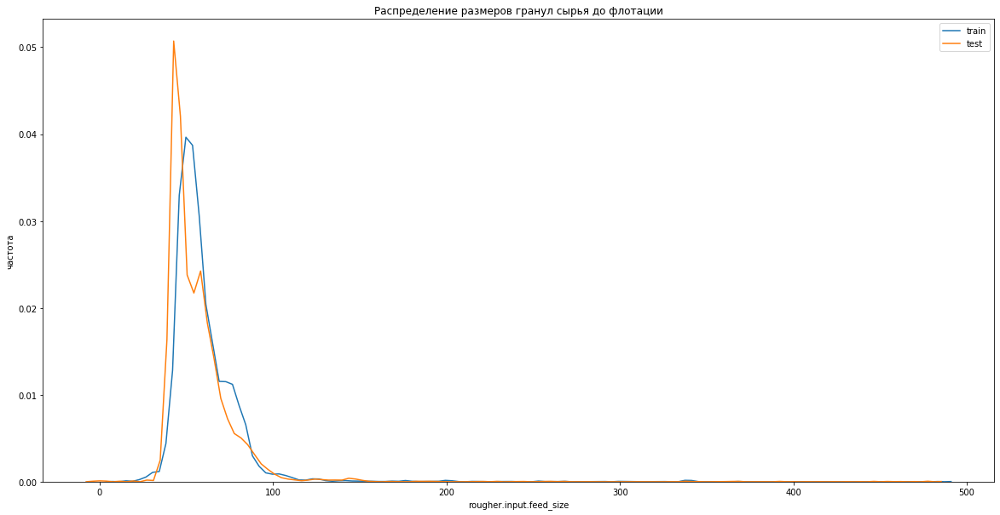

In [ ]:
fig, ax = plt.subplots(figsize=(20,10))
plt.title('Распределение размеров гранул сырья до флотации')
plt.xlabel('размеры гранул')
plt.ylabel('частота')
sns.distplot(data_train['rougher.input.feed_size'], hist=False, ax=ax, label = 'train')
sns.distplot(data_test['rougher.input.feed_size'], hist=False, ax=ax, label = 'test')
plt.show()



In [ ]:
data_train['rougher.input.feed_size'].describe()

count    14149.000000
mean        60.239856
std         23.005310
min          9.659576
25%         48.966751
50%         55.269784
75%         66.007526
max        484.967466
Name: rougher.input.feed_size, dtype: float64

In [ ]:
data_test['rougher.input.feed_size'].describe()

count    5383.000000
mean       56.338644
std        21.836788
min         0.046369
25%        43.913766
50%        50.924232
75%        62.364984
max       477.445473
Name: rougher.input.feed_size, dtype: float64

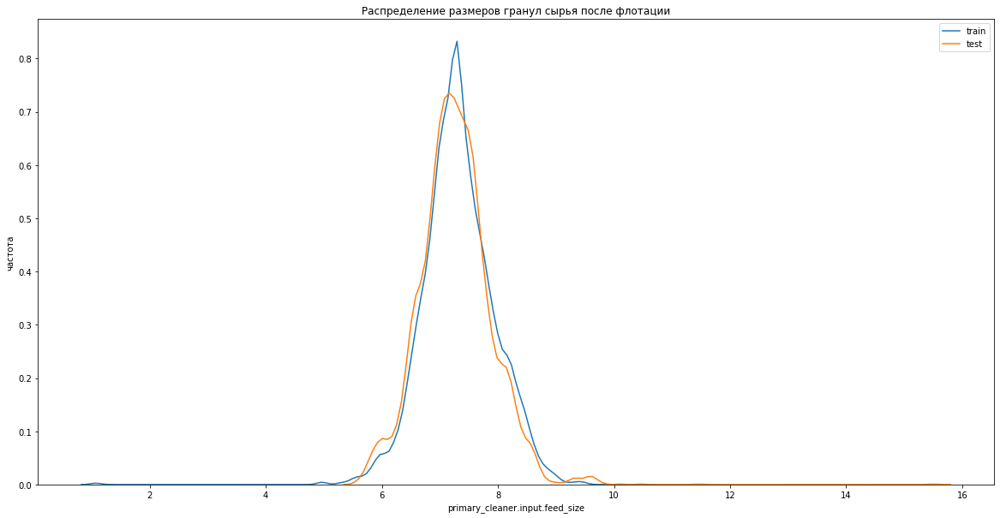

In [ ]:


fig, ax = plt.subplots(figsize=(20,10))
plt.title('Распределение размеров гранул сырья после флотации')
plt.xlabel('размеры гранул')
plt.ylabel('частота')
sns.distplot(data_train['primary_cleaner.input.feed_size'], hist=False, ax=ax, label = 'train')
sns.distplot(data_test['primary_cleaner.input.feed_size'], hist=False, ax=ax, label = 'test')
plt.show()



Распределение размеров гранул сырья до флотации смещено вправо, есть выбросы - очень крупные значения, видимо крупные куски руды. Удалять их не будем, так как они есть и в тестовой, и в обучающей выборке. Модели нужно уметь иметь с ними дело. Хоть сами распределения и отличаются, основаная масса размеров лежит в промежутке между 40 и 100, что соответствует индустриальным стандартам. 

Посмотрим на распределение суммарных концентраций веществ на каждом этапе очистки.

In [ ]:
data_full['rougher.input.feed_sum'] = data_full['rougher.input.feed_pb'] + data_full['rougher.input.feed_ag']+ data_full['rougher.input.feed_au']
data_full['rougher.output.concentrate_sum'] = data_full['rougher.output.concentrate_ag'] + data_full['rougher.output.concentrate_au']+ data_full['rougher.output.concentrate_pb']
data_full['primary_cleaner.output.concentrate_sum'] = data_full['primary_cleaner.output.concentrate_au'] + data_full['primary_cleaner.output.concentrate_ag'] + data_full['primary_cleaner.output.concentrate_pb']
data_full['final.output.concentrate_sum'] = data_full['final.output.concentrate_ag']+ data_full['final.output.concentrate_au'] +data_full['final.output.concentrate_pb']

In [ ]:
df_fullmetals = data_full[['rougher.input.feed_sum', 'rougher.output.concentrate_sum', 'primary_cleaner.output.concentrate_sum', 'final.output.concentrate_sum']].stack()

df_fullmetals = df_fullmetals.to_frame()
df_fullmetals.reset_index(inplace=True)
df_fullmetals.rename(columns={0:'value'}, inplace=True)
fig = px.histogram(df_fullmetals, x="value", color="level_1",
                   hover_data=df_fullmetals.columns, barmode="overlay")
fig.show()

Как и ожидалось, суммарная концентрация веществ растёт от этапа к этапу. По видимому в основном за счет роста концентрации золота. Но наблюдается большое количество нулевых значений. Это очевидно ошибки в данных, так как в руде не может быть абсолютно нулевых концентраций элементов. Удалим такие строки:

In [ ]:
index_zeros = data_full[(data_full['rougher.input.feed_sum'] <5) | 
                        (data_full['rougher.output.concentrate_sum'] <5) | 
                        (data_full['primary_cleaner.output.concentrate_sum'] <5) | 
                        (data_full['final.output.concentrate_sum'] <5)].index
data_train = data_train[~data_train.index.isin(index_zeros)]
data_test = data_test[~data_test.index.isin(index_zeros)]
data_test.shape, data_train.shape

((5160, 52), (13578, 54))

Проверим признаки на мультиколлинеарность:

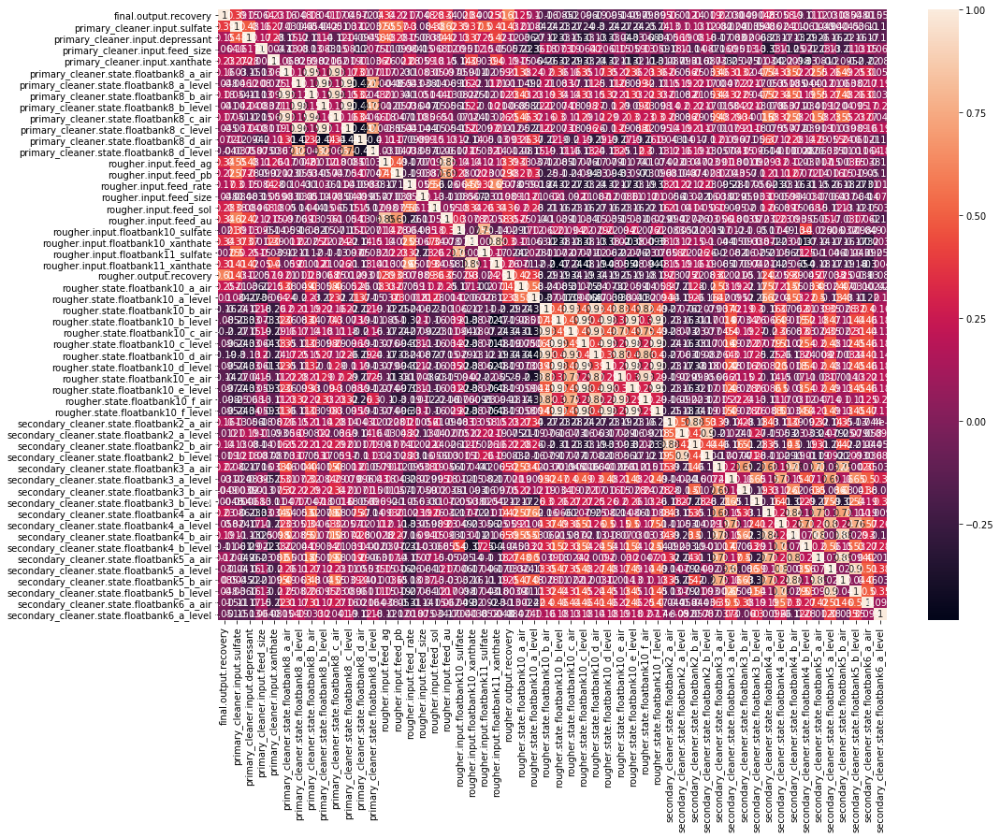

In [ ]:
corrMatrix = data_train.corr()
f, ax = plt.subplots(figsize=(16, 12))
ax = sns.heatmap(corrMatrix, annot=True)
plt.show()

Видно, что признаков с мультиколлинеарностью очень много. Но график нечитаемый, поэтому представим данные в виде таблицы и удалим признаки с корреляцией более 0.7:

In [ ]:
corrMatrix_stacked = corrMatrix.stack()
corrMatrix_stacked = corrMatrix_stacked.to_frame().reset_index()
corrMatrix_stacked.rename(columns={0:'value'}, inplace=True)
corrMatrix_stacked.loc[(corrMatrix_stacked['value']>.7)].sort_values(by='value').head(100)

,level_0,level_1,value
2477,secondary_cleaner.state.floatbank4_a_level,secondary_cleaner.state.floatbank4_b_level,0.709852
2583,secondary_cleaner.state.floatbank4_b_level,secondary_cleaner.state.floatbank4_a_level,0.709852
2208,secondary_cleaner.state.floatbank3_a_air,secondary_cleaner.state.floatbank5_a_air,0.711744
2632,secondary_cleaner.state.floatbank5_a_air,secondary_cleaner.state.floatbank3_a_air,0.711744
658,primary_cleaner.state.floatbank8_d_level,primary_cleaner.state.floatbank8_c_level,0.714954
552,primary_cleaner.state.floatbank8_c_level,primary_cleaner.state.floatbank8_d_level,0.714954
2744,secondary_cleaner.state.floatbank5_b_air,secondary_cleaner.state.floatbank4_a_air,0.720333
2426,secondary_cleaner.state.floatbank4_a_air,secondary_cleaner.state.floatbank5_b_air,0.720333
656,primary_cleaner.state.floatbank8_d_level,primary_cleaner.state.floatbank8_b_level,0.723457
444,primary_cleaner.state.floatbank8_b_level,primary_cleaner.state.floatbank8_d_level,0.723457


In [ ]:
multicorr_columns=['secondary_cleaner.state.floatbank5_a_air', 
                   'secondary_cleaner.state.floatbank4_a_level',
                   'secondary_cleaner.state.floatbank5_b_air', 
                   'rougher.input.feed_pb', 'primary_cleaner.state.floatbank8_d_level', 
                   'secondary_cleaner.state.floatbank4_b_air', 
                   'rougher.state.floatbank10_c_air', 'rougher.input.floatbank11_sulfate', 
                   'rougher.state.floatbank10_b_air', 'rougher.input.feed_ag', 
                   'rougher.state.floatbank10_d_air', 'secondary_cleaner.state.floatbank2_b_air', 
                   'secondary_cleaner.state.floatbank5_a_level', 'secondary_cleaner.state.floatbank2_a_level', 
                   'rougher.input.floatbank11_xanthate', 'rougher.state.floatbank10_e_air', 
                   'primary_cleaner.state.floatbank8_a_air', 'rougher.state.floatbank10_b_level', 
                   'primary_cleaner.state.floatbank8_b_air', 'rougher.state.floatbank10_c_level', 
                   'primary_cleaner.state.floatbank8_a_level', 'rougher.state.floatbank10_d_level', 
                   'primary_cleaner.state.floatbank8_b_level', 'rougher.state.floatbank10_e_level' ]
data_train_dropped_multicorr = data_train.drop(multicorr_columns, axis=1)
data_test_dropped_multicorr = data_test.drop(multicorr_columns, axis=1)
data_train_dropped_multicorr.info()

<class 'pandas.core.frame.DataFrame'>
Index: 13578 entries, 2016-01-15 00:00:00 to 2018-08-18 10:59:59
Data columns (total 30 columns):
final.output.recovery                         13578 non-null float64
primary_cleaner.input.sulfate                 13578 non-null float64
primary_cleaner.input.depressant              13578 non-null float64
primary_cleaner.input.feed_size               13578 non-null float64
primary_cleaner.input.xanthate                13578 non-null float64
primary_cleaner.state.floatbank8_c_air        13578 non-null float64
primary_cleaner.state.floatbank8_c_level      13578 non-null float64
primary_cleaner.state.floatbank8_d_air        13578 non-null float64
rougher.input.feed_rate                       13578 non-null float64
rougher.input.feed_size                       13578 non-null float64
rougher.input.feed_sol                        13578 non-null float64
rougher.input.feed_au                         13578 non-null float64
rougher.input.floatbank10_sulfate   

Предобработка и анализ закончены, переходим к построению моделей. 

## Модель

Напишем функцию SMAPE для оценки качества модели:

In [ ]:
def smape(y_true, y_pred):
    i = abs(y_true - y_pred) / (abs(y_true) + abs(y_pred)) * 2
    k = i.sum() / len(y_true) * 100
    return k

def final_smape(y_true, y_pred):
    rougher = smape(y_true.iloc[:, 0], y_pred[:, 0])
    final = smape(y_true.iloc[:, 1], y_pred[:, 1])
    return 0.25 * rougher + 0.75 * final

Выделим целевой признак из обучающей выборки, найдем целевой признак в полной таблице для тестовой выборки:

In [ ]:
features_train = data_train_dropped_multicorr.drop(['rougher.output.recovery', 'final.output.recovery'], axis = 1)
target_train = data_train_dropped_multicorr[['rougher.output.recovery', 'final.output.recovery']]

features_test = data_test_dropped_multicorr

target_test = data_full.loc[data_test_dropped_multicorr.index][['rougher.output.recovery', 'final.output.recovery']]
target_test.shape, features_test.shape, features_train.shape, target_train.shape

((5160, 2), (5160, 28), (13578, 28), (13578, 2))

Станартизируем данные, так как значения некоторых признаков отличаются на несколько порядков:

In [ ]:
scaler = StandardScaler()
scaler.fit(features_train)
features_train = scaler.transform(features_train)
features_test = scaler.transform(features_test)

Подготовим свой оценщик на основе написанной выше функции SMAPE.

In [ ]:
scorer = make_scorer(final_smape, greater_is_better = False)

Обучим линейную регрессию и найдем среднее smape:

In [ ]:
model_linear = LinearRegression()
scores = cross_val_score(model_linear, features_train, target_train, cv = 5, scoring = scorer)
print('sMAPE:', mean(scores))


Обучим дерево решений, переберем гиперпараметры с помощью RandomizedSearchCV и найдем smape на лучших параметрах: 

In [ ]:
param_grid = {'max_depth': np.arange(1, 50)}
model2 = DecisionTreeRegressor(random_state=12345)

search_tree = RandomizedSearchCV(model2, param_grid, cv=10, scoring=scorer)
search_tree.fit(features_train, target_train)

print('Гиперпараметры:', search_tree.best_params_)
print('sMAPE:', -(search_tree.best_score_))

Гиперпараметры: {'max_depth': 2}
sMAPE: 8.897342790226135


Обучим случайный лес, переберем гиперпараметры с помощью RandomizedSearchCV и найдем smape на лучших параметрах: 

In [ ]:
param_grid = {'n_estimators': np.arange(2, 25), 
 'max_depth': np.arange(10, 50)}


model3 = RandomForestRegressor(random_state=12345)
search_forest = RandomizedSearchCV(model3, param_grid, scoring=‘f1’)
search_forest.fit(features_train, target_train)

print('Гиперпараметры:', search_forest.best_params_)
print('sMAPE:', -(search_forest.best_score_))

Гиперпараметры: {'n_estimators': 13, 'max_depth': 18}
sMAPE: 8.79067156528526


Выбираем модель линейной регресии. Она совсем незначительно хуже случайного леса, но работает быстрее и хорошо интерпретируема. 

## Проверка модели

Проверим модель на тестовой выборке и сравним с фиктивной моделью.

In [ ]:
model_linear.fit(features_train, target_train)
predictions_test = model_linear.predict(features_test)
print('Итоговое значение sMAPE на тестовой выборке: ', final_smape(target_test, predictions_test))

Итоговое значение sMAPE на тестовой выборке:  7.069437915561576


In [ ]:
dummy_model = DummyRegressor()
dummy_model.fit(features_train, target_train)
dummy_smape = final_smape(target_test, dummy_model.predict(features_test))

print(dummy_smape)

7.701844704520346


Наша модель отработала на тестовой выборке лучше, чем фиктивная, поэтому считаем её успешной. 

## Вывод


Основная цель работы - построение модели по прогнозированию коэффициента восстановления золота из золотосодержащей руды - выполнена.
Модель предсказывает коэффициент восстановления золота из золотосодержащей руды с величной smape = 6.93%.

